O departamento da empresa de ecommerce Eletronic deseja saber, no intervalo de tempo de setembro de 2023 até setembro de 2024, os produtos mais vendidos da loja, o consumo dos produtos de acordo com a faixa etária,a taxa de cancelamento de compras, a relação do cancelamento da compra com algum produto da loja, relação de cancelamento com o rating dos produtos e o faturamento dos produtos da loja. A análise desses dados tem como finalidade melhorar as campanhas de marketing da empresa

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

Transformando o arquivo csv dos dados em um dataframe 

In [2]:
df = pd.read_csv('Electronic_sales_Sep2023-Sep2024.csv')
df.head()

,Customer ID,Age,Gender,Loyalty Member,Product Type,SKU,Rating,Order Status,Payment Method,Total Price,Unit Price,Quantity,Purchase Date,Shipping Type,Add-ons Purchased,Add-on Total
0,1000,53,Male,No,Smartphone,SKU1004,2,Cancelled,Credit Card,5538.33,791.19,7,2024-03-20,Standard,"Accessory,Accessory,Accessory",40.21
1,1000,53,Male,No,Tablet,SKU1002,3,Completed,Paypal,741.09,247.03,3,2024-04-20,Overnight,Impulse Item,26.09
2,1002,41,Male,No,Laptop,SKU1005,3,Completed,Credit Card,1855.84,463.96,4,2023-10-17,Express,NaN,0.00
3,1002,41,Male,Yes,Smartphone,SKU1004,2,Completed,Cash,3164.76,791.19,4,2024-08-09,Overnight,"Impulse Item,Impulse Item",60.16
4,1003,75,Male,Yes,Smartphone,SKU1001,5,Completed,Cash,41.50,20.75,2,2024-05-21,Express,Accessory,35.56


Como a análise desses dados vai ser utilizada por uma filial da empresa no Brasil. Decidi modificar a língua dos dados do arquivo para o português brasileiro, só fiz a modificação nas colunas Order Status e Product Type

In [3]:
for i in range(0, len(df['Order Status'])): 
    if df['Order Status'][i] == 'Cancelled': 
        df['Order Status'][i] = 'Cancelado' 
    elif df['Order Status'][i] == 'Completed': 
        df['Order Status'][i] = 'Completado'     

for i in range(0, len(df['Payment Method'])): 
    if df['Payment Method'][i] == 'Cash': 
        df['Payment Method'][i] = 'Dinheiro' 
    elif df['Payment Method'][i] == 'Credit Card': 
        df['Payment Method'][i] = 'Cartão de Crédito'  
    elif df['Payment Method'][i] == 'Debit Card': 
        df['Payment Method'][i] = 'Cartão de Débito' 
    elif df['Payment Method'][i] == 'Bank Transfer': 
        df['Payment Method'][i] = 'Transferência Bancária'

C:\Users\euler\AppData\Local\Temp\ipykernel_13000\1868449151.py:3: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df['Order Status'][i] = 'Cancelado'
C:\Users\euler\AppData\Local\Temp\ipykernel_13000\1868449151.py:3: SettingWithCopyWarning: 


## Tratamento dos dados

Verificando a ocorrência de dados nan (not an number, ou seja, dados que não um número)

In [4]:
df.isna().sum()

Customer ID             0
Age                     0
Gender                  1
Loyalty Member          0
Product Type            0
SKU                     0
Rating                  0
Order Status            0
Payment Method          0
Total Price             0
Unit Price              0
Quantity                0
Purchase Date           0
Shipping Type           0
Add-ons Purchased    4868
Add-on Total            0
dtype: int64

A coluna Add-ons Purchased refere-se a items que o cliente adicionou na compra. Os valores que são nan (not a number, ou seja, não são um número) nessa coluna existem porque o cliente não comprou nada, para não haver inconsistências na análise vou substituilos por uma string do seguinte valor "None item purchased" 

In [8]:
df['Add-ons Purchased'] = df['Add-ons Purchased'].fillna('None item purchased') 
df.head()

,Customer ID,Age,Gender,Loyalty Member,Product Type,SKU,Rating,Order Status,Payment Method,Total Price,Unit Price,Quantity,Purchase Date,Shipping Type,Add-ons Purchased,Add-on Total
0,1000,53,Male,No,Smartphone,SKU1004,2,Cancelado,Cartão de Crédito,5538.33,791.19,7,2024-03-20,Standard,"Accessory,Accessory,Accessory",40.21
1,1000,53,Male,No,Tablet,SKU1002,3,Completado,Paypal,741.09,247.03,3,2024-04-20,Overnight,Impulse Item,26.09
3,1002,41,Male,Yes,Smartphone,SKU1004,2,Completado,Dinheiro,3164.76,791.19,4,2024-08-09,Overnight,"Impulse Item,Impulse Item",60.16
4,1003,75,Male,Yes,Smartphone,SKU1001,5,Completado,Dinheiro,41.50,20.75,2,2024-05-21,Express,Accessory,35.56
5,1004,41,Female,No,Smartphone,SKU1001,5,Completado,Cartão de Crédito,83.00,20.75,4,2024-05-26,Standard,"Impulse Item,Accessory",65.78


Excluindo dados nan

In [7]:
df = df.dropna() 
df.isna().sum()

Customer ID          0
Age                  0
Gender               0
Loyalty Member       0
Product Type         0
SKU                  0
Rating               0
Order Status         0
Payment Method       0
Total Price          0
Unit Price           0
Quantity             0
Purchase Date        0
Shipping Type        0
Add-ons Purchased    0
Add-on Total         0
dtype: int64

Verificando a ocorrência de dados duplicados

In [6]:
print(f'Quantidade de dados duplicados: {df.duplicated().sum()}')

Quantidade de dados duplicados: 0


# Lista de produtos mais vendidos

In [5]:
list_produtos_mais_vendidos = pd.DataFrame(df['Product Type'].value_counts())
list_produtos_mais_vendidos.index.name = 'index'
list_produtos_mais_vendidos

,count
index,
Smartphone,5978
Tablet,4104
Laptop,3973
Smartwatch,3934
Headphones,2011


Text(0, 0.5, ' ')

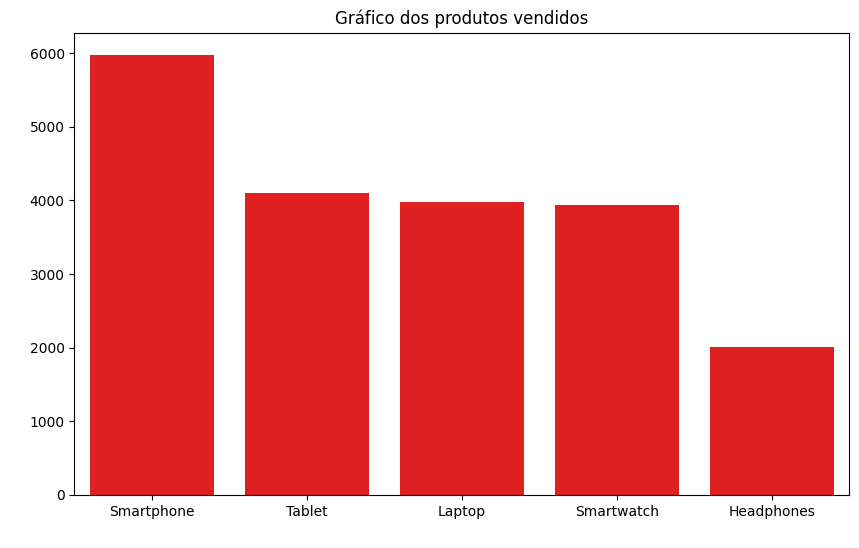

In [9]:
plt.figure(figsize=(10,6))
sns.barplot(data=list_produtos_mais_vendidos, x=list_produtos_mais_vendidos.index, y='count', color='red')
plt.title('Gráfico dos produtos vendidos')
plt.xlabel(' ')
plt.ylabel(' ')

# Consumo dos produtos de acordo com a faixa etária

In [10]:
faixa_etaria = pd.DataFrame(df.groupby('Product Type')['Age'].apply(lambda x: x.mode().iloc[0]))
faixa_etaria 

,Age
Product Type,
Headphones,28
Laptop,40
Smartphone,61
Smartwatch,71
Tablet,42


Text(0, 0.5, ' ')

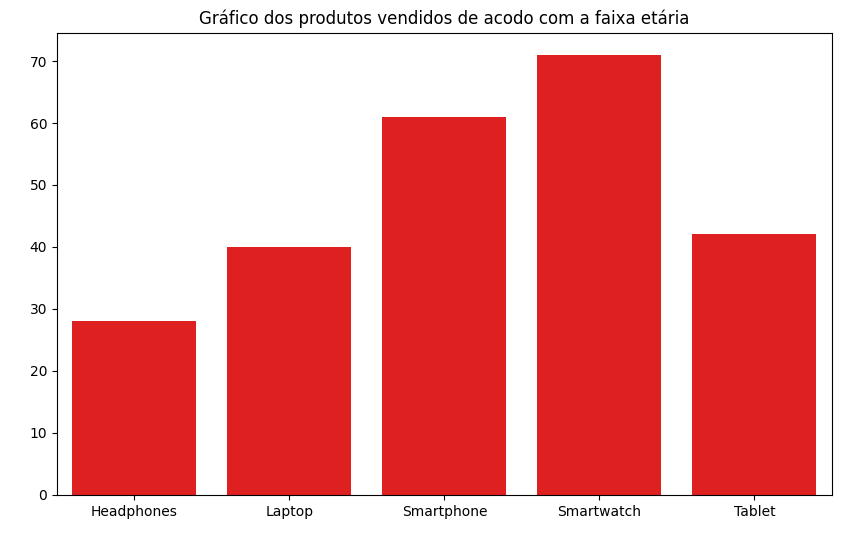

In [11]:
faixa_etaria.index.name = 'index'
plt.figure(figsize=(10,6))
sns.barplot(data=faixa_etaria, x=faixa_etaria.index, y='Age', color='red')
plt.title('Gráfico dos produtos vendidos de acodo com a faixa etária')
plt.xlabel(' ')
plt.ylabel(' ')

# A taxa de cancelamento do envio de produtos

In [12]:
taxa_cancelamento = pd.DataFrame(df['Order Status'].value_counts())
taxa_cancelamento.index.name = 'index'
taxa_cancelamento

,count
index,
Completado,10145
Cancelado,4987


Text(0, 0.5, ' ')

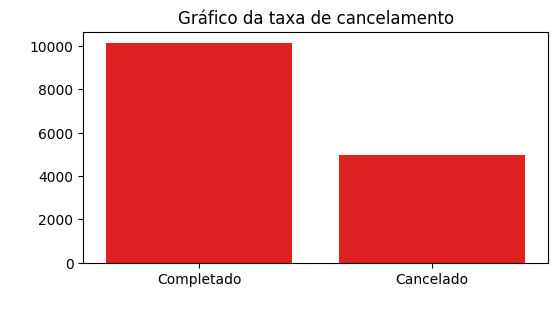

In [13]:
plt.figure(figsize=(6,3))
sns.barplot(data=taxa_cancelamento, x=taxa_cancelamento.index, y='count', color='red')
plt.title('Gráfico da taxa de cancelamento')
plt.xlabel(' ')
plt.ylabel(' ')

# Relação de cancelamento com os produtos

In [14]:
cancelamento = df[df['Order Status'].str.contains('Cancelado')]
taxa_cancelamento_produto = pd.DataFrame(cancelamento['Product Type'].value_counts())
taxa_cancelamento_produto

,count
Product Type,
Smartphone,1482
Tablet,1033
Smartwatch,1007
Laptop,971
Headphones,494


Text(0, 0.5, ' ')

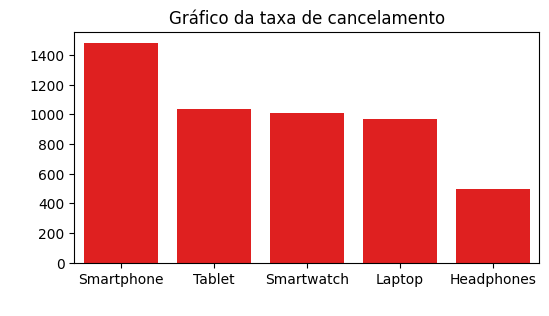

In [15]:
taxa_cancelamento_produto.index.name = 'index'
plt.figure(figsize=(6,3))
sns.barplot(data=taxa_cancelamento_produto, x=taxa_cancelamento_produto.index, y='count', color='red')
plt.title('Gráfico da taxa de cancelamento')
plt.xlabel(' ')
plt.ylabel(' ')

# Relação de cancelamento com o rating dos produtos

In [16]:
taxa_cancelamento_ratings = pd.DataFrame(cancelamento['Rating'].value_counts()) 
taxa_cancelamento_ratings

,count
Rating,
3,1975
2,999
5,978
1,534
4,501


Text(0, 0.5, ' ')

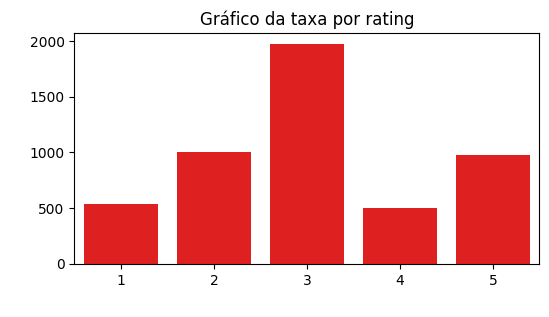

In [17]:
taxa_cancelamento_ratings.index.name = 'index'
plt.figure(figsize=(6,3))
sns.barplot(data=taxa_cancelamento_ratings, x=taxa_cancelamento_ratings.index, y='count', color='red')
plt.title('Gráfico da taxa por rating')
plt.xlabel(' ')
plt.ylabel(' ')

# Faturamento dos produtos da loja

In [18]:
faturamento_produtos = pd.DataFrame(df.groupby('Product Type')['Total Price'].sum()) 
faturamento_produtos

,Total Price
Product Type,
Headphones,3069826.04
Laptop,9283696.65
Smartphone,16163288.35
Smartwatch,10794190.06
Tablet,8873249.21


Text(0, 0.5, ' ')

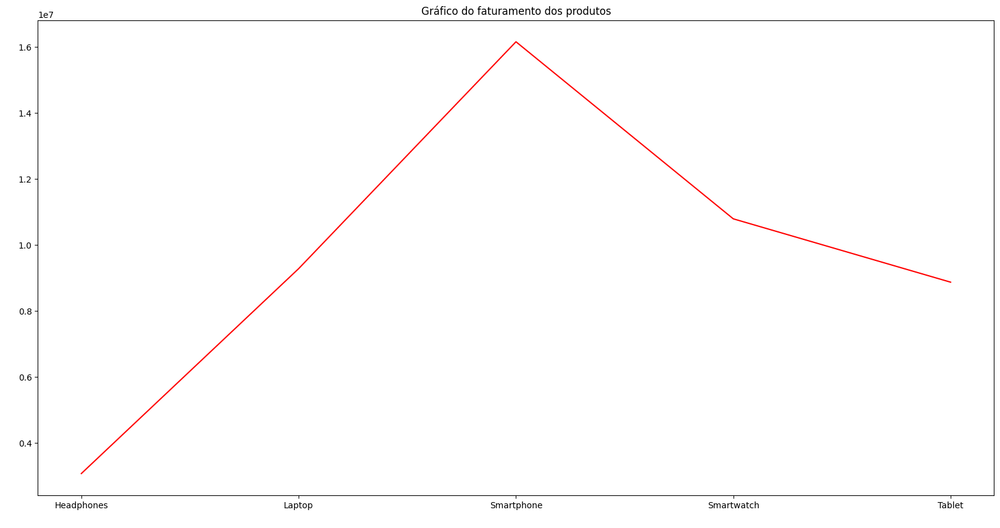

In [19]:
faturamento_produtos.index.name = 'index'
plt.figure(figsize=(20,10))
sns.lineplot(data=faturamento_produtos, x=faturamento_produtos.index, y='Total Price', color='red')
plt.title('Gráfico do faturamento dos produtos')
plt.xlabel(' ')
plt.ylabel(' ')

# Faturamento Total

In [20]:
tot_faturamento = df['Total Price'].sum()
print(f'Faturamento total: R$ {tot_faturamento:.2f}')

Faturamento total: R$ 48184250.31


# Exportando dados editados

In [30]:
df.to_csv('new_Electronic_sales_Sep2023-Sep2024.csv') 